# Dimension reduction

--------------

Let's follow the video as below to check is there any different with PCA

https://www.youtube.com/watch?v=nq6iPZVUxZU

------------------

Note for the video (Up-coming topic for investigation):

Technique for dimention reduction:

1) Matrix factorization

- PCA

- Linear autoencoder

- Latent Dirichlet Allocation

- Non-negative Matrix factorization

- Generalised Low Rank Model

- Work2Vec

- GloVe

-------------------------------------------

2) Neighbor graph

- Laplacian eigenmap

- Hessian eigenmaps

- Local tangent space alignment

- JSE

- isomap

- t-SNE

- Local linear embedding

- UMAP

----------------------------

##### UMAP

1) Need to find nearest neighbour very effciently

RP-tree + NN-descent

2) Need to optimize the layout subquadratically

SGD + negative sampling

3) Need to be high level but still fast

Python + numba (much faster than t-SNE)

Embed new unseen point into existing embedding

- Make use of labels for supervised dimension reduction

- Combine those for metric learning

https://github.com/lmcinnes/umap

- Combine space with different metrics

- Workable with pandas dataframe

##### Installation

> conda install -c conda-forge umap-learn

> pip install umap-learn

https://www.youtube.com/watch?v=6BPl81wGGP8

Different with PCA

- PCA (matrix factorization)

> NMF + SVD

- UMAP (Neighbour graph)

> t-SNE

##### TWO step

1. High dimensional construction

    A. Step
    
        i. Mapping to a low dimensional graph

        ii. Approximate the high dimensional data's shape/ topology (Nerve theorem)

        iii. Single data point (0-simplex) -> connect it to form 1-simplex/ 2-simplex or higher dimension

        iv. UAMP extend a radius around each point and make a connection between each point and its neighbour 
            with insercting radii

        v. Originally, Those radii are equal.

    B. Problem 

        i. Not connnection for the point with large gap (Low density region)

           Forming too much/ complex group when there is too much neighbours (High density region)

        ii. the curse of dimensionality (distances between point become more and more similar)

    C. Solution

        i. Using variable radius instead (Riemennian metrics)

           - UMAP does not estimate the density as a number but uses a proxy:

           - Density was estimated as high if the kth neighbor is close & lower when the kth neighbour 
             is far away.

           - Hyperparameter: kth neighbour (Help to find the right local radius)

                * Big kth -> more global structure is preserved

                * Small kth -> radius decrease and the local structure is more preserved 

           - No perfect & automatical way to find the best kth

           - Some trial & error is needed & kth depends on each data set individually

           - Different neighbor get different distances & neighbour get a weight and connection probability

           - Point far away are weighted less & low connection probability

    D. High dimension graph was constructed and ready to project to low dimension.
    
2. Graph Projection
    A. Step
    
        i. the edges being springs, where each spring is stronger as the edge probability increases.
        
        ii. High weight edges are more likely to stay together in the low dimensional space
        
        iii. spring forces is rotationally symmetric -> leads the cluster land on one side and on the
             other side after another projection.

##### Comparison with t-SNE:

- Faster due to optimizations & strong mathematical foundations

- Better balance between locality and globality in clustering

### Code for UMAP

I tried the code from the video but it's not working. I just got another code from Kaggle and I would like to investigate it step by step with MNIST data set. Also, I will try to modify some code for having more unterstanding.

Reference: https://www.kaggle.com/parulpandey/part3-visualising-kannada-mnist-with-umap

In [1]:
# basic set up

from keras.datasets import mnist
import numpy as np
import umap
import matplotlib.pyplot as plt
import matplotlib.patheffects as PathEffects
import seaborn as sns
import pandas as pd
%matplotlib inline
sns.set(style = 'white', context = 'notebook', rc={'figure.figsize':(14,10)})

from sklearn.preprocessing import StandardScaler
import time
import warnings
warnings.filterwarnings(action = 'ignore')

import plotly.express as px

Init Plugin
Init Graph Optimizer
Init Kernel


In [2]:
# load the data and check with the sample size & image size
(train_X, train_y), (test_X, test_y)= mnist.load_data()
print(train_X.shape)

(60000, 28, 28)


In [3]:
# create an umap object & fit the reshaped data (flatten 28*28 pixels)
reducer = umap.UMAP(random_state = 42)
# count the time for comparison
start = time.time()
embedding = reducer.fit_transform(train_X.reshape(60000,28*28))
end = time.time()
umap_2d_time = end - start

OMP: Info #271: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


Text(0.5, 1.0, 'Visualizing MNIST with UMAP')

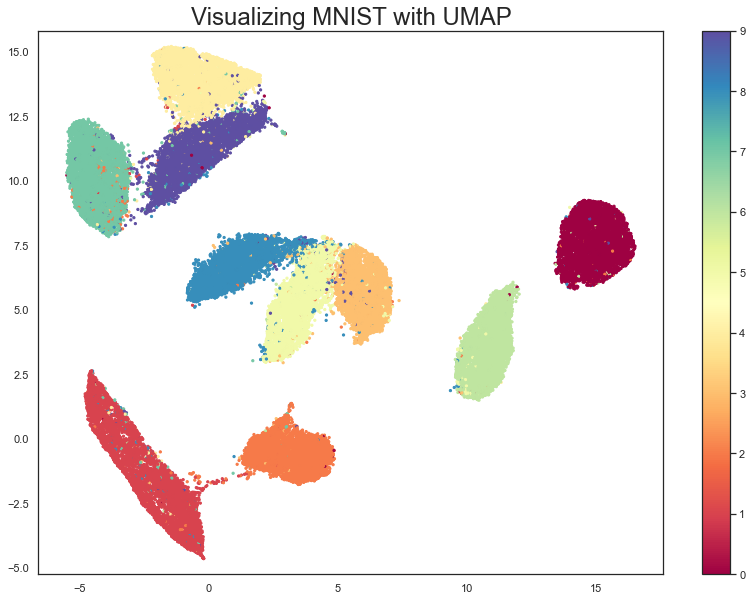

In [4]:
# plot a scatter plot and check with the cluster according to the class
plt.scatter(reducer.embedding_[:,0], reducer.embedding_[:,1], s = 5, c = train_y, cmap = 'Spectral')
# Eqaul for both axis and limit the data point
plt.gca().set_aspect('equal','datalim')
# Set a color bar to check with the number & color match
plt.colorbar(boundaries=np.arange(11)-0.5). set_ticks(np.arange(10))
# Set the title for the graph
plt.title("Visualizing MNIST with UMAP", fontsize = 24)

In the reference notebook, Bokeh was suggested to be used for display of plot but it will raise a lot warnings for the factor matching the palette. I decided to use plotly for the display of 3D projection of UMAP

In [5]:
# create a umap model with 3 dimension
umap_3d = umap.UMAP(n_components = 3, random_state = 42)
# fit the data into the model for 3D projection
start = time.time()
proj_3d = umap_3d.fit_transform(train_X.reshape(60000,28*28))
end = time.time()
umap_3d_time = end - start

In [6]:
# plot the scatter plot with 3d projected data and classifiy it according to the color (not able in Github)
fig = px.scatter_3d(
    proj_3d, x = 0, y = 1, z = 2,
    color = train_y)
# set the marker in size 1
fig.update_traces(marker_size = 1)
fig.show()

From the above graph, different cluster was form due to the similarity of data.

Some of the point was missed but obvious major of data can be identified and form a cluster.

------------

##### t-SNE

Let's work on the TSNE with the same data set and check how much time it used for fit& transform the data. Also, we can go deeper for the TSNE which is another technique that we used to reduce dimension.

To compare, UMAP is more time efficient compared to TSNE when the number of data point increase.That's also the people will use UMAP instead of TSNE now.

Reference:
https://www.youtube.com/watch?v=NEaUSP4YerM (StatQuest) 

https://www.kaggle.com/parulpandey/visualizing-kannada-mnist-with-t-sne

https://plotly.com/python/t-sne-and-umap-projections/ (plotly) (Simplest way to plot instead of other library)

(PS. It is a great channel and it is worth to take note and understand statistic from it)

##### Installation/Import

> from sklearn.manifold import TSNE

##### Step

1. Data projection
    A. Determine the similarity of all point
        i. Calculate the distance of target point with the others
        ii. The distant points have low similarity value/ the closer point have high similarity value
        iii. Scale the unscaled similarities and make it add up to 1 (Scale wont affect the result)
        iv. End up with a matrix of similarity scores
    B. Project the data into a low dimension space (e.g. 2-D scatter plot -> 1-D number line)
        i. Put/ project all the points on the number line in random order
        ii. t-SNE moves theses point until those data point was clustered
        iii. Each point will move closer to the preserved cluster data point
        iv. the point from other cluster will push it back
        v. the moving will be stopped once clusters on number line was formed
        
I just note it down simply and please correct it if there is any missing.

##### Code for t-SNE

In [7]:
# basic set up
from sklearn.manifold import TSNE

Good way to learn about how to plot image through matplotlib and the attribute for different function

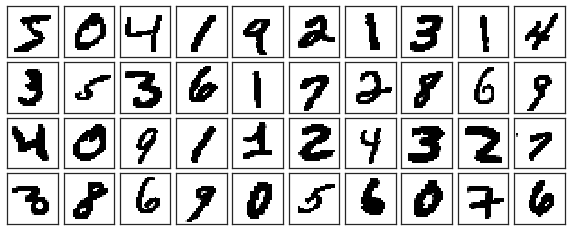

In [8]:
# plot the original image
def plot_digits(data):
    # set up the plots with 4 rows & 10 columns
    fig, axes = plt.subplots(4, 10, figsize=(10,4),
                             # subplot_kw: key word passed to add_subplot
                             subplot_kw={'xticks':[], 'yticks':[]},
                             # gridspec_kw: key word passed to GridSpec (Create the grid the subplot are placed on)
                             gridspec_kw = dict(hspace = 0.1, wspace = 0.1))
    # imshow function was used to show image
    for i, ax in enumerate(axes.flat):
        ax.imshow(data[i].reshape(28,28),
                 # cmap: colormap used to map scalar data to colors
                 # interpolation: method used for interpolation
                 # clim: color limit of the current image
                 cmap = 'binary', interpolation = 'nearest',
                 clim = (0,16))
        
plot_digits(train_X)

In [9]:
# set up the model with different hyperparameters
tsne = TSNE(random_state= 42, n_components = 2)

In [10]:
start = time.time()
# fit the data and count for the time needed
projections = tsne.fit_transform(train_X.reshape(60000,28*28))
end = time.time()
tsne_2d_time = end - start

Text(0.5, 1.0, 'Visualizing MNIST with t-SNE')

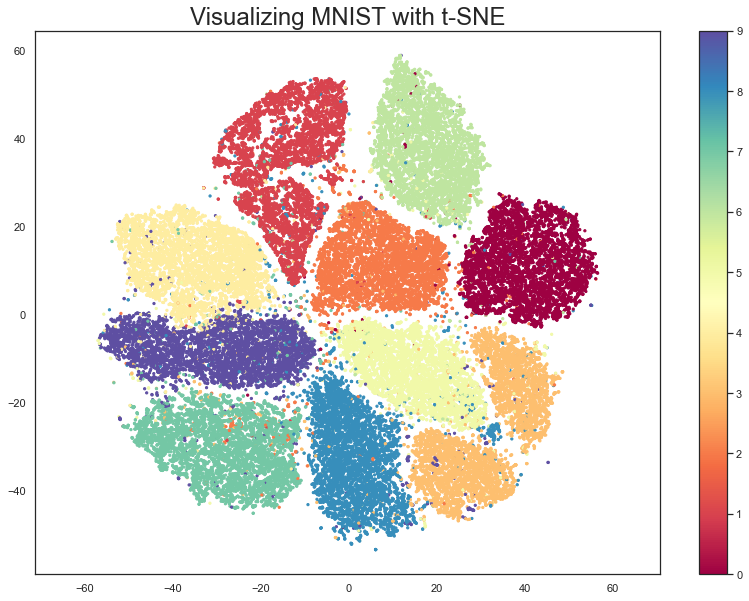

In [15]:
# plot a scatter plot and check with the cluster according to the class
plt.scatter(projections[:,0], projections[:,1], s = 5, c = train_y, cmap = 'Spectral')
# Eqaul for both axis and limit the data point
plt.gca().set_aspect('equal','datalim')
# Set a color bar to check with the number & color match
plt.colorbar(boundaries=np.arange(11)-0.5). set_ticks(np.arange(10))
# Set the title for the graph
plt.title("Visualizing MNIST with t-SNE", fontsize = 24)

After the projection to 2D, let's project it into 3D by using t-SNE

In [16]:
# set up a model for 3D projection
tsne = TSNE(random_state = 42, n_components = 3)

In [17]:
# fit the data for projection & count the time needed
start = time.time()
projections = tsne.fit_transform(train_X.reshape(60000,28*28))
end = time.time()
tsne_3d_time = end - start

In [18]:
# show the 3D plot (Not able in Github)
fig = px.scatter_3d(projections, x = 0, y = 1, z = 2, color = train_y)
# set the marker with size 1
fig.update_traces(marker_size = 1)
fig.show()

In [19]:
# construction for the time comparison data frame
comparison_result = pd.DataFrame()
tsne_time = [tsne_2d_time, tsne_3d_time]
umap_time = [umap_2d_time, umap_3d_time]
comparison_result['TSNE'] = tsne_time
comparison_result['UMAP'] = umap_time
comparison_result['Dimension'] = ['2D','3D']
comparison_result.set_index('Dimension', inplace = True)
comparison_result

,TSNE,UMAP
Dimension,,
2D,217.547054,29.225143
3D,482.535341,27.033518


For time, we can see that UMAP work faster than TSNE in both 2D & 3D projection. Also, it is more than 10 - 17 times by comparing the fitting time. UMAP do really work better on time effcient.

For clustering performance, we can see that UMAP work better on both locality & globality. Same data point getting closer within the cluster & the gap between each cluster is larger than t-SNE as well.

Therefore, it is much easier to review the whole set of data in low dimension by using UMAP.